In [1]:
import numpy as np
import pandas as pd

import cv2
import json
import os
import random
import matplotlib.pyplot as plt

from PIL import Image, ImageEnhance


In [2]:
class_names=['cat','dog']
with open('cat_dog_annotations.json', 'r') as f:
    json_dict = json.load(f)


In [3]:
json_dict.keys()

dict_keys(['_via_settings', '_via_img_metadata', '_via_attributes'])

In [4]:
data=json_dict["_via_img_metadata"].values()

In [5]:
# Process the images and regions
annotations = []
for image in data:
    filename = image["filename"]
    width, height = None, None
    with Image.open(filename) as img:       
        width, height = img.size
    for region in image["regions"]:
        class_name = list(region["region_attributes"]["class"].keys())[0]
        x, y, w, h = region["shape_attributes"]["x"], region["shape_attributes"]["y"], region["shape_attributes"]["width"], region["shape_attributes"]["height"]
        center_x = (x + w/2) / width
        center_y = (y + h/2) / height
        norm_w = w / width
        norm_h = h / height
        class_id = class_names.index(class_name)
        annotations.append(f"{class_id} {center_x} {center_y} {norm_w} {norm_h}\n")
print("annotations_file is appended successfully")


annotations_file is appended successfully


In [6]:
# Step 5: Save the YOLO formatted annotations and labels
with open("yolo_annotations.txt", "w") as f:
    f.writelines(annotations)
print("annotations.txt is created successfully and saved in current directory\n")

annotations.txt is created successfully and saved in current directory



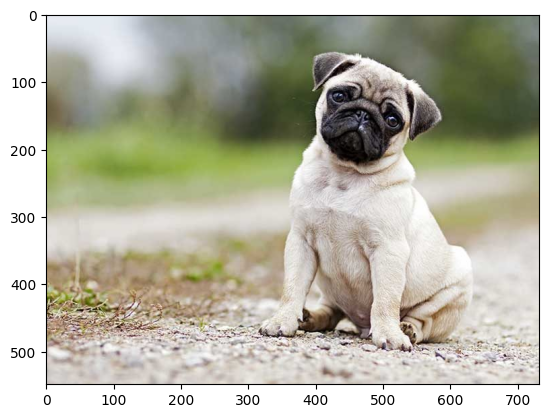

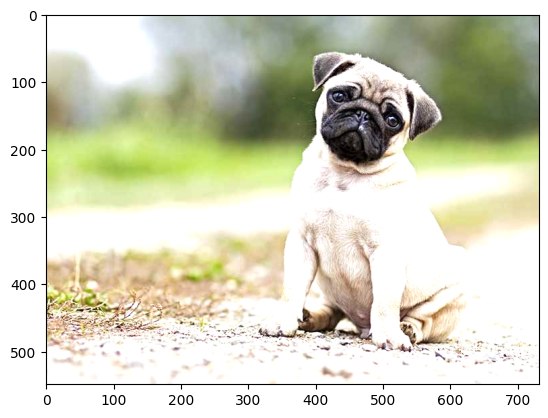

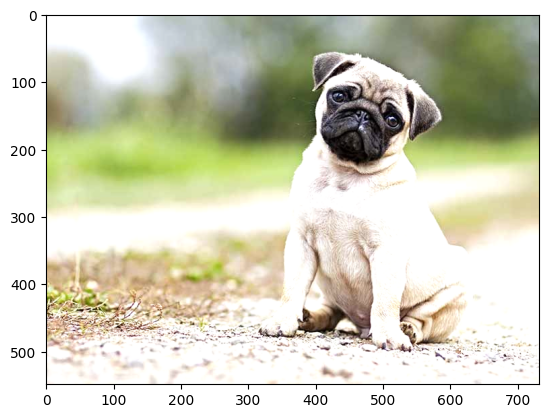

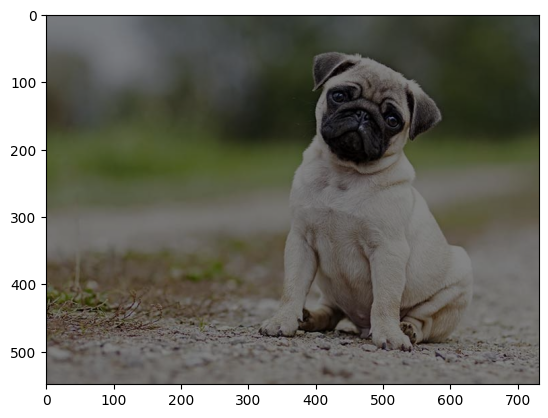

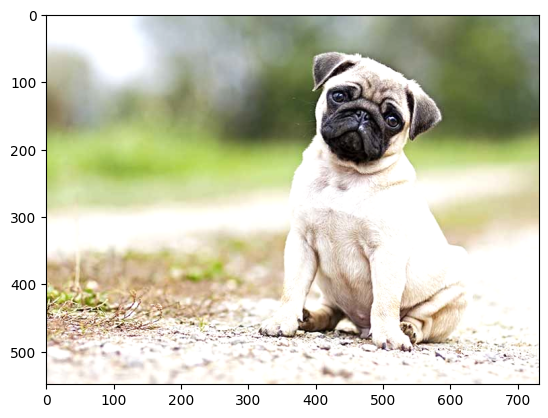

...

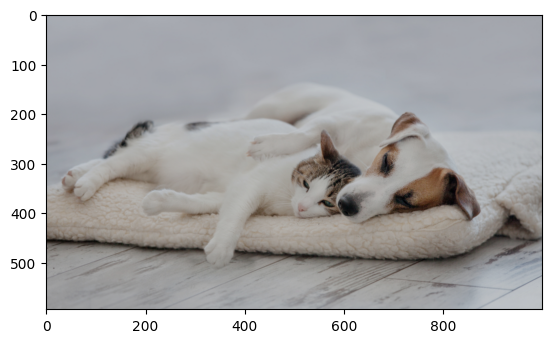

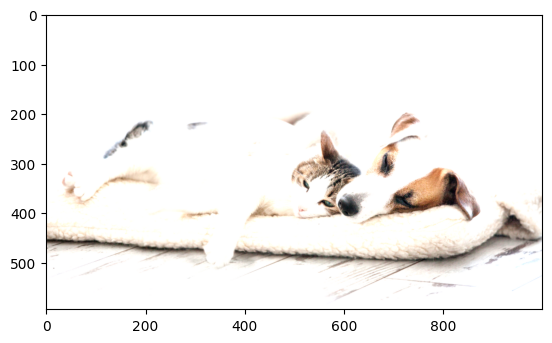

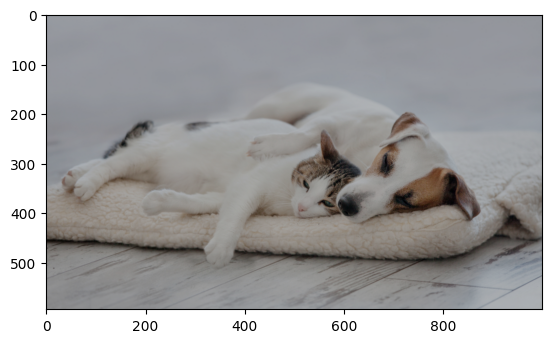

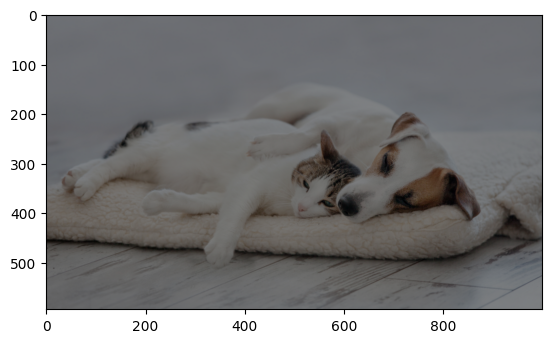

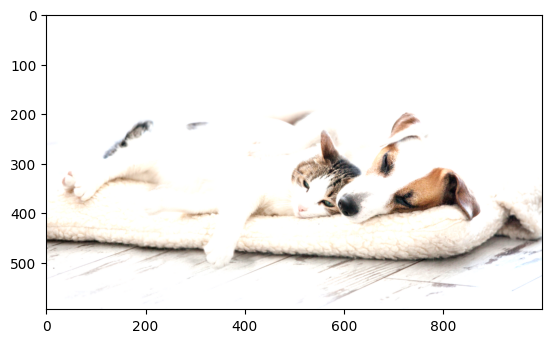

In [7]:
#part brightness

input_dir = 'images/'

output_dir = 'brightness_and_noisy_image/'
num_levels = 5
# loop through all files

for filename in os.listdir(input_dir):
    
     # load the image
    orig_filename = "original_" + filename    

    img = Image.open(os.path.join(input_dir, filename))
    
    img.save(os.path.join(output_dir, orig_filename))

    
    plt.imshow(img)
    plt.show()
    for i in range(num_levels):
         # generate a random brightness value between 0.5 and 1.5
        brightness = random.uniform(0.5, 1.5)
        # create a new image with the modified brightness
        

        enhancer = ImageEnhance.Brightness(img)
        img_mod = enhancer.enhance(brightness)
        output_filename = f'{os.path.splitext(filename)[0]}_brightness_{i}.jpg'
        img_mod.save(os.path.join(output_dir, output_filename))
        
        # save the original image with a new filename


        
        
        
        plt.imshow(img_mod)
        plt.show()

    
    
    
   
    


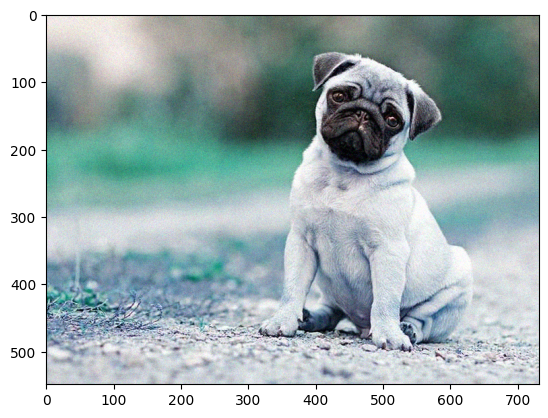

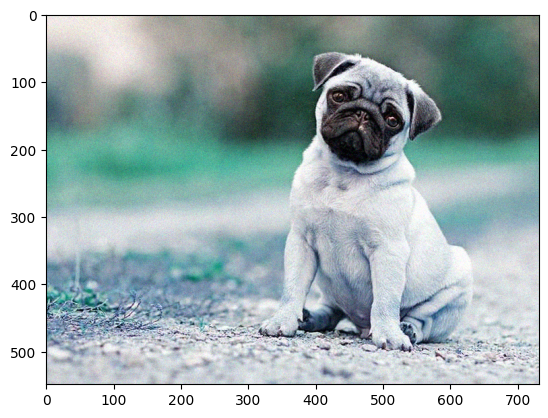

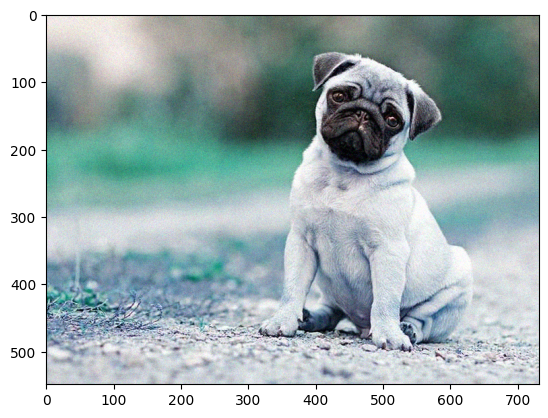

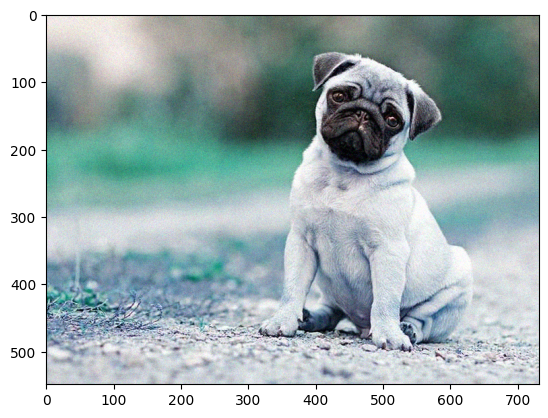

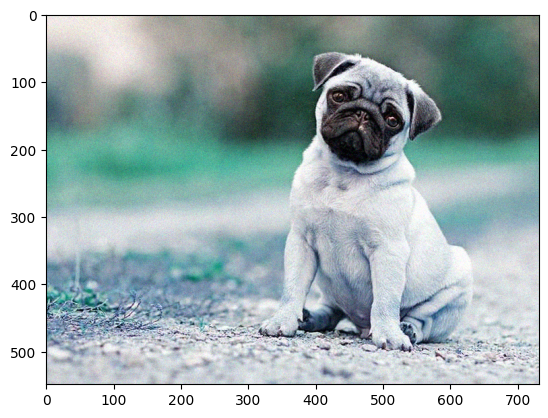

...

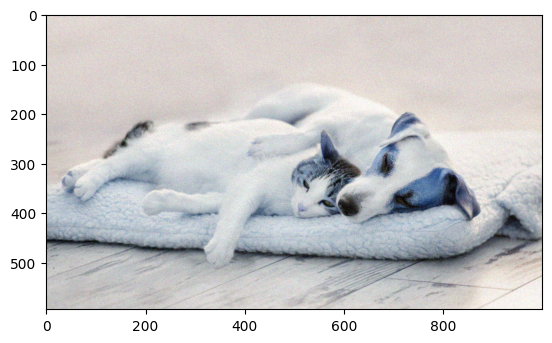

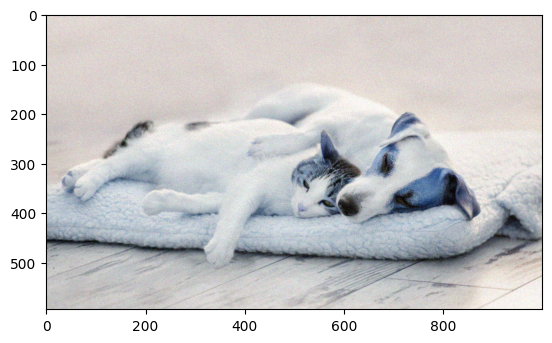

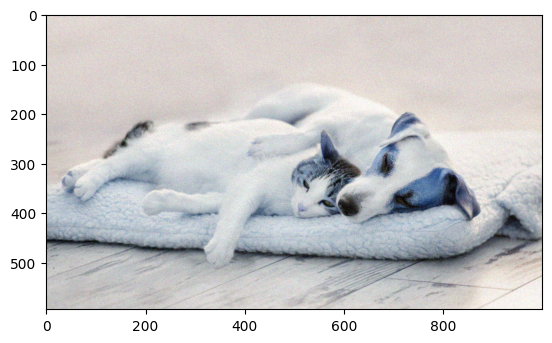

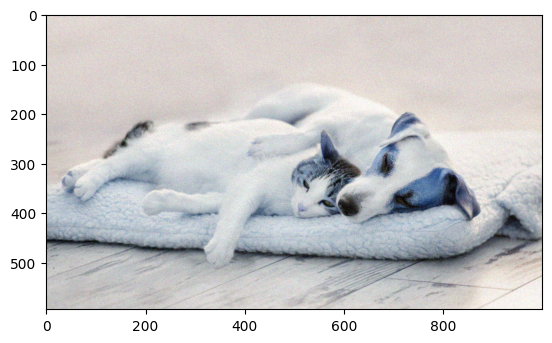

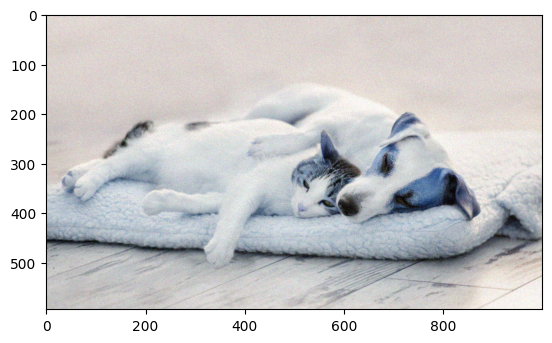

In [8]:
#part noisy 3

import cv2
import os
import numpy as np

# Path to the folder containing the images
input_dir = "images/"
output_dir = "brightness_and_noisy_image/"

# Define the standard deviation of the Gaussian noise
sigma = 10

# Loop over all the images in the folder
for filename in os.listdir(input_dir):
    # Load the image
    image_path = os.path.join(input_dir, filename)
    image = cv2.imread(image_path)

    # Add Gaussian noise to the image
    noise = np.random.normal(0, sigma, size=image.shape)
    noisy_image = np.clip(image + noise, 0, 255).astype(np.uint8)

    # Save the noisy image
    for i in range(5):
        cv2.imwrite(os.path.join(output_dir, f"{filename[:-4]}_noisy_{i}.jpg"), noisy_image)
        plt.imshow(noisy_image)
        plt.show()


#Adding both brightness and noisy code to make a label.txt file of them 

In [9]:
import cv2
import os
import numpy as np

# Path to the folder containing the images
input_dir = "images/"
output_dir = "brightness_and_noisy_image/"

# Define the standard deviation of the Gaussian noise
sigma = 10

# Create a labels file
labels_file = open(os.path.join(output_dir, "labels.txt"), "w")

# Loop over all the images in the folder
for filename in os.listdir(input_dir):
    # Load the image
    image_path = os.path.join(input_dir, filename)
    image = cv2.imread(image_path)

    # Add Gaussian noise to the image
    noise = np.random.normal(0, sigma, size=image.shape)
    noisy_image = np.clip(image + noise, 0, 255).astype(np.uint8)

    # Save the noisy image
    for i in range(5):
        output_filename = f"{filename[:-4]}_noisy_{i}.jpg"
        cv2.imwrite(os.path.join(output_dir, output_filename), noisy_image)
        labels_file.write(output_filename + " noisy\n")
        
    # Modify brightness of the image
    orig_filename = "original_" + filename
    img = Image.open(os.path.join(input_dir, filename))
    img.save(os.path.join(output_dir, orig_filename))
    labels_file.write(orig_filename + " original\n")
    
    num_levels = 5
    for i in range(num_levels):
        # Generate a random brightness value between 0.5 and 1.5
        brightness = random.uniform(0.5, 1.5)
        # Create a new image with the modified brightness
        enhancer = ImageEnhance.Brightness(img)
        img_mod = enhancer.enhance(brightness)
        output_filename = f'{os.path.splitext(filename)[0]}_brightness_{i}.jpg'
        img_mod.save(os.path.join(output_dir, output_filename))
        labels_file.write(output_filename + f" brightness_{i}\n")

# Close the labels file
labels_file.close()
